In [3]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io.wavfile import read
from IPython.display import Audio

# Filtros adaptativos

El principio de operación de un filtro adaptativo son sus característica variables en el tiempo autoajustables. Un filtro adaptativo usualmente toma la forma de un filtro FIR, con un algoritmo de adaptación que continuamente actualiza los coeficientes del filtro, tal que la señal de error se minimiza de acuerdo a cierto criterio. La señal de error usualmente es derivada de alguna manera desde diagrama de flujo de la aplicación, tal que sea una medida de qué tan cerca el filtro está del óptimo. La mayoría de algoritmos de adaptación pueden ser llamados aproximaciones al filtro Wiener, el cuál es de vital importancia para el entendimiento de los filtros adaptativos. [1]

## 1. Least Mean Squares (LMS)

El algoritmo de los mínimos cuadrados medios es extremadamente popular por su simplicidad y facilidad de computación. El algoritmo está basado en el método de gradiente descendiente, pero es aún más simple ya que solo ejecuta una iteración por muestra, y además, calcula solo un estimado del vector gradiente por cada muestra.
<p style="text-align: center;"> $w_{k+1}(i) = w_k (i) + 2 \mu e_k x_{k-i}$, para $i$ desde $0$ hasta $N - 1$ </p>
El parámetro $\mu$ es una constante que regula la estabilidad y rapidez de convergencia, para calcular el valor del error se usa:
<p style="text-align: center;"> $e_k = y_k - \sum\limits_{i=0}^{N-1} w(i) \cdot x_{k-i}$ </p>

### 1.1. Cargue el archivo `voice.wav` que contiene una pista de voces, grafique la señal y reproduzca el audio.

/tmp/ipykernel_21045/4021322259.py:2: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, voice = read("voice.wav")


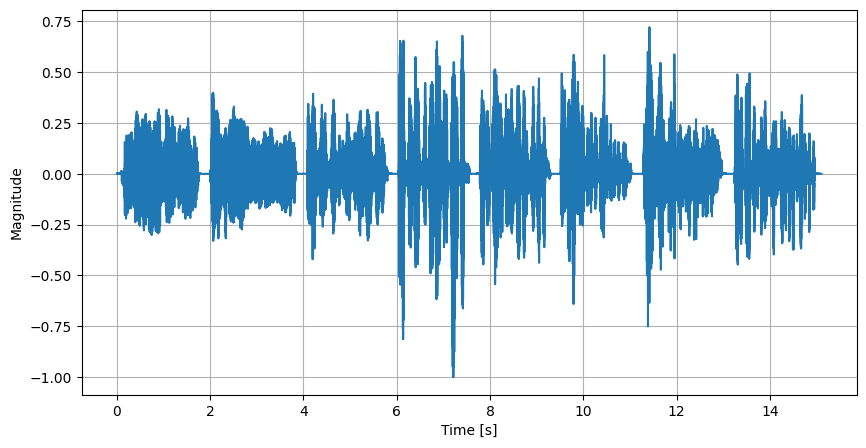

In [4]:
# Cargar el audio
fs, voice = read("voice.wav")

# Normalizar el audio
normalize = lambda x: x / float(max(abs(x)))

voice = normalize(voice)

t1 = np.arange(0, float(len(voice))/fs, 1.0/fs)

# Graficar
plt.figure(figsize=(10, 5))
plt.plot(t1, voice)
plt.xlabel("Time [s]")
plt.ylabel("Magnitude")
plt.grid()
plt.show()

# Reproducir audio
Audio(voice, rate=fs)

### 1.2. Cargue el archivo `rock.wav` que contiene una pista musical, grafique la señal y reproduzca el audio.

/tmp/ipykernel_21045/866973064.py:2: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, music = read("rock.wav");


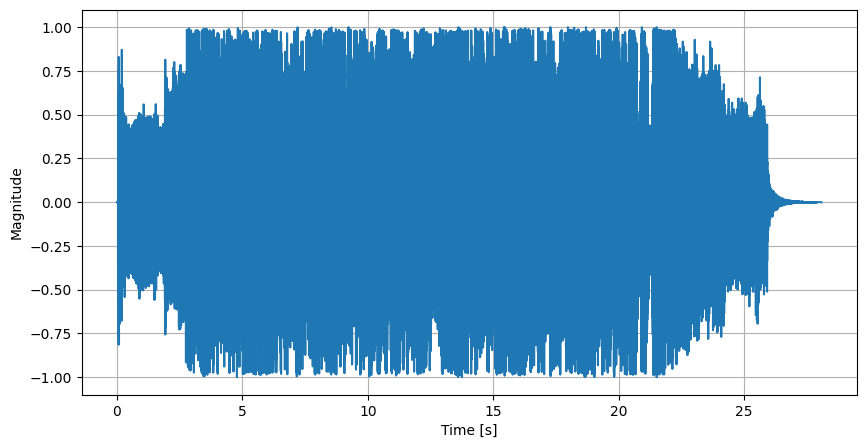

In [5]:
# Cargar el audio
fs, music = read("rock.wav");

music = normalize(music)

t2 = np.arange(0, float(len(music))/fs, 1.0/fs)

# Graficar
plt.figure(figsize=(10, 5))
plt.plot(t2, music)
plt.xlabel("Time [s]")
plt.ylabel("Magnitude")
plt.grid()
plt.show()

# Reproducir audio
Audio(music, rate=fs)

### 1.3. Ahora combine los dos audios, asegurándose que las voces queden al final de la señal sin alargarlas (no concatenar), reproduzca el resultado.

In [6]:
L = max(len(voice), len(music))
music = np.pad(music, [0, L - len(music)])
voice = np.pad(voice, [L - len(voice), 0])
combined = voice + music

Audio(combined, rate=fs)

### 1.4. Utilice el filtro LMS para deshacerse de la música, tome $\mu = 0.1$, reproduzca el resultado ¿Fue posible aislar las voces? ¿Por qué algunas resultaron distorsionadas y otras no? Puede ayudarse de la siguiente función para implementar el filtro LMS.

In [19]:
def lms(x, d, N = 4, mu = 0.1):
    nIters = min(len(x), len(d)) - N
    # Copia de la señal
    u = np.zeros(N)
    # Coeficientes del filtro
    w = np.zeros(N)
    # Salida del filtro
    n = np.zeros(nIters)
    # Error estimado
    e = np.zeros(nIters)
    for k in range(nIters):
        # Tomar una copia de la señal
        u[1:] = u[:-1]
        u[0] = x[k]
        # Calcular la salida del filtro
        n[k] = np.dot(u, w)
        # Calcular el error estimado
        e_k = d[k] - n[k]
        # Actualizar los pesos del filtro
        w = w + 2*mu * e_k * u
        e[k] = e_k
    return n

In [20]:
filtered_audio = lms(combined, voice, mu=0.1)
Audio(filtered_audio, rate=fs)

Sí, las voces fueron exitosamente aisladas del audio, sin embargo estas quedaron afectadas por ruido en donde la música se superponía con ellas, es por eso que la última voz no resultó afectada, ya que la música se detiene justo antes de esta.

### 1.5. Aplique el filtro para los valores de $\mu$ de 0.001, 0.1 y 0.2, concluya.

In [39]:
mu = 0.001
filtered_audio = lms(combined, voice, mu=mu)
Audio(filtered_audio, rate=fs)

In [40]:
mu = 0.1
filtered_audio = lms(combined, voice, mu=mu)
Audio(filtered_audio, rate=fs)

In [41]:
mu = 0.2
filtered_audio = lms(combined, voice, mu=mu)
Audio(filtered_audio, rate=fs)

En los valores de $\mu$ bajos el filtro no alcanza a atenuar la señal indeseada completamente, esto porque el valor tan bajo de $\mu$ no le permite una rápida convergencia en un mínimo del error, para el valor de 0.1, se observa que la música es casi imperceptible, aunque la señal fue desafortunadamente distorsionada, para el valor de 0.2 el filtro tiene una retroalimentación tan alta que la señal se ve completamente atenuada.